## StableDiffusion 1.4 

In [25]:
from diffusers import UNet2DConditionModel, StableDiffusionPipeline
import torch


BASE_MODEL = "CompVis/stable-diffusion-v1-4"
BASE_PATH ="../../scratch/unlearningbaselines/localscratch/damon2024/DM_baselines/ALL_baseline_ckpt/object"

def load_erased_model(object_name, method):
    
    original_model = StableDiffusionPipeline.from_pretrained(BASE_MODEL, safety_checker=None, feature_extractor=None)

    
    suffix = "-noxattn.pt" if method == "ESD" else ".pt"
    unet_path = f"{BASE_PATH}/{method}/{method}-{object_name}-Diffusers-UNet{suffix}"

    erased_model = StableDiffusionPipeline.from_pretrained(BASE_MODEL, safety_checker=None, feature_extractor=None)

    unet = UNet2DConditionModel.from_pretrained(BASE_MODEL, subfolder="unet")
    unet.load_state_dict(torch.load(unet_path))

    erased_model.unet = unet


    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    erased_model.to(device)
    original_model.to(device)
    
    return original_model, erased_model


object_name = "Garbage_Truck"  
method = "EraseDiff"         

original_model, erased_model = load_erased_model(object_name, method)


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .
/tmp/ipykernel_3533011/1686927364.py:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.

  0%|          | 0/50 [00:00<?, ?it/s]

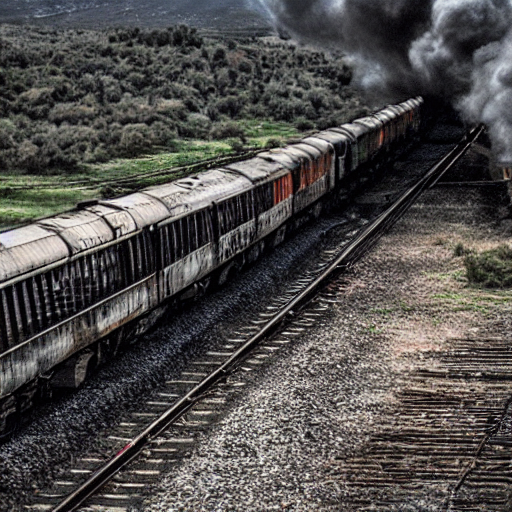

In [15]:
prompt = "a dirty train is riding on the tracks"

image = original_model(prompt).images[0]
image.show()

  0%|          | 0/50 [00:00<?, ?it/s]

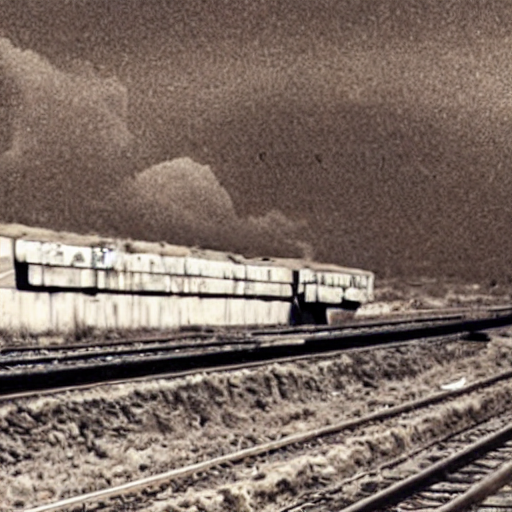

In [16]:
image = erased_model(prompt).images[0]
image.show()

  0%|          | 0/50 [00:00<?, ?it/s]

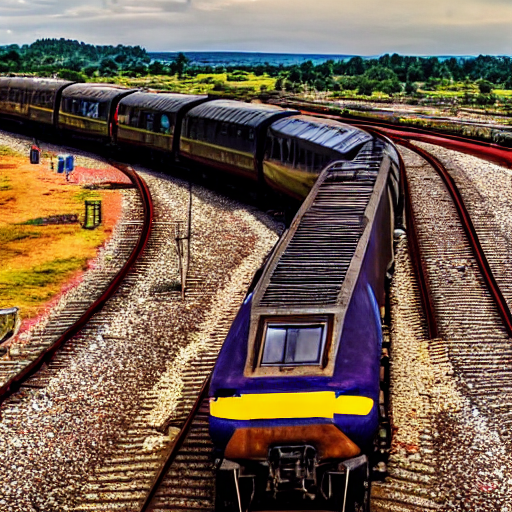

In [26]:
prompt = "a dirty train is riding on the tracks"
image = original_model(prompt).images[0]
image.show()


  0%|          | 0/50 [00:00<?, ?it/s]

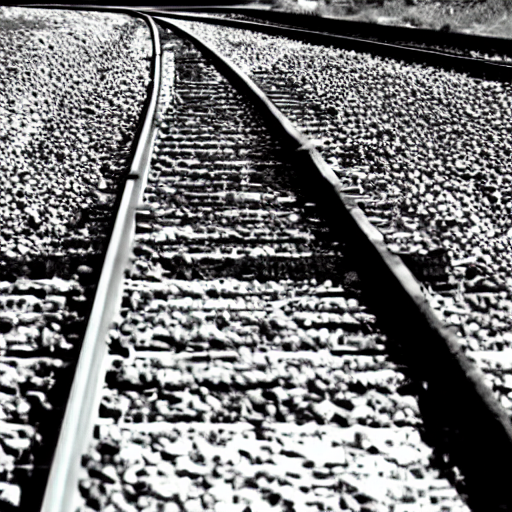

In [28]:
image = erased_model(prompt).images[0]
image.show()

### Loading COCO captions

In [29]:
import os
import urllib.request
import zipfile
from pycocotools.coco import COCO

def download_and_extract_dataset_COCO(url, data_dir):
    
    os.makedirs(data_dir, exist_ok=True)
    file_path = os.path.join(data_dir, 'annotations.zip')

    if not os.path.exists(file_path):
        print("Downloading the annotations...")
        urllib.request.urlretrieve(url, file_path)

    if not os.path.exists(os.path.join(data_dir, 'annotations')):
        print("Extracting the annotations...")
        with zipfile.ZipFile(file_path, 'r') as zip_ref:
            zip_ref.extractall(data_dir)
        os.remove(file_path)
 
 
def load_captions(annotations_path):

    coco = COCO(annotations_path)

    img_ids = coco.getImgIds()

    all_captions = []
    for img_id in img_ids:
        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)
        img_captions = [ann['caption'].lower() for ann in anns]
        all_captions.extend(img_captions)

    return all_captions

        
def load_coco():
    data_dir = '../scratch/coco_annotation'
    annotations_url = "http://images.cocodataset.org/annotations/annotations_trainval2017.zip"

    download_and_extract_dataset_COCO(annotations_url, data_dir)

    annotations_train_path = os.path.join(data_dir, 'annotations', 'captions_train2017.json')
    annotations_val_path = os.path.join(data_dir, 'annotations', 'captions_val2017.json')

    all_captions_train = load_captions(annotations_train_path)
    all_captions_val = load_captions(annotations_val_path)

    all_captions = all_captions_train + all_captions_val

    print(f"Total number of captions (train): {len(all_captions_train)}")
    print(f"Total number of captions (val): {len(all_captions_val)}")
    print(f"Total number of captions (train + val): {len(all_captions)}")

    return all_captions

all_captions = load_coco()

Extracting the annotations...
loading annotations into memory...
Done (t=0.58s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Total number of captions (train): 591753
Total number of captions (val): 25014
Total number of captions (train + val): 616767


In [30]:
len(all_captions)

616767

### Loading LM 

In [31]:
from tqdm import tqdm
import os
import json
import numpy as np
import torch
import torch.nn.functional as F
import torch
from transformers import CLIPModel, CLIPTokenizer, CLIPProcessor
import torch
from transformers import AutoTokenizer, BertModel
import torch
import numpy as np

from sentence_transformers import SentenceTransformer

from transformers import AutoTokenizer, AutoModel


In [32]:
home_dir = os.path.expanduser("~")

cache_dir = os.path.join(home_dir, "scratch/SD/") 

def load_bert_model():
    bert_model = SentenceTransformer('paraphrase-distilroberta-base-v1', cache_folder = cache_dir)
    return bert_model

def load_bert_large_model():
    bert_model = SentenceTransformer('sentence-transformers/all-roberta-large-v1', cache_folder = cache_dir)
    return bert_model


def load_clip_model():
    model = CLIPModel.from_pretrained('openai/clip-vit-large-patch14', cache_dir= cache_dir)
    model = model.cuda()
    tokenizer = CLIPTokenizer.from_pretrained('openai/clip-vit-large-patch14',cache_dir=cache_dir)
    processor = CLIPProcessor.from_pretrained("openai/clip-vit-large-patch14",cache_dir=cache_dir)
    return model, tokenizer, processor



clip_model, clip_tokenizer, clip_processor = load_clip_model()

bert_model = load_bert_model()

bert_large_model = load_bert_large_model()

### Calculating similarity and filtering 

In [46]:

def calculate_bert_cosine_sim(sentence1, sentence2, bert_model):
    embedding1 = bert_model.encode(sentence1, convert_to_tensor=True)
    embedding2 = bert_model.encode(sentence2, convert_to_tensor=True)
    
    embeddings = torch.nn.functional.normalize(torch.stack([embedding1, embedding2]), p=2, dim=-1)
    cosine_sim = torch.matmul(embeddings[0], embeddings[1].T)
    return cosine_sim.item()


def calculate_clip_score(sentence1, sentence2, model, processor):
    inputs = processor(text=[sentence1, sentence2], return_tensors="pt", padding=True)
    input_ids = inputs["input_ids"].cuda()
    attention_mask = inputs["attention_mask"].cuda()

    with torch.no_grad():
        outputs = model.get_text_features(input_ids=input_ids, attention_mask=attention_mask)
        
    embeddings = torch.nn.functional.normalize(outputs, p=2, dim=-1)
    cosine_sim = torch.matmul(embeddings[0], embeddings[1].T)
    return cosine_sim.item()


def calculate_clip_scores_batch(prompt, batch_captions, model, processor):
    texts = [prompt] + batch_captions 
    inputs = processor(text=texts, return_tensors="pt", padding=True, truncation=True)
    input_ids = inputs["input_ids"].cuda()
    attention_mask = inputs["attention_mask"].cuda()

    with torch.no_grad():
        outputs = model.get_text_features(input_ids=input_ids, attention_mask=attention_mask)

    embeddings = torch.nn.functional.normalize(outputs, p=2, dim=-1)
    
    prompt_embed = embeddings[0] 
    captions_embed = embeddings[1:] 
    
    cosine_sims = torch.matmul(captions_embed, prompt_embed.T)  
    
    return cosine_sims.cpu().tolist()



In [34]:
# This function is heavy to run so use the next cell
def filter_captions_by_similarity(prompt, captions, clip_model, clip_processor, bert_model,
                                  clip_threshold=0.5, bert_threshold=0.5, batch_size=32):

    filtered_captions = []
    
    for i in tqdm(range(0, len(captions), batch_size), desc="Processing captions"):
        if len(filtered_captions) > 10:
            break
        batch = captions[i:i + batch_size]
        
        clip_scores = [calculate_clip_score(prompt, caption, clip_model, clip_processor) for caption in batch]
        bert_scores = [calculate_bert_cosine_sim(prompt, caption, bert_model) for caption in batch]

        for caption, clip_score, bert_score in zip(batch, clip_scores, bert_scores):
            if clip_score > clip_threshold and bert_score < bert_threshold:
                filtered_captions.append((caption, clip_score, bert_score))
    
    return filtered_captions

In [44]:
def filter_captions_by_similarity(prompt, captions, clip_model, clip_processor,
                                  clip_threshold=0.8, batch_size=32):
    filtered_captions = []
    high_clip_captions = []

    for i in tqdm(range(0, len(captions), batch_size), desc="Filtering by CLIP score"):
        batch = captions[i:i + batch_size]
        clip_scores = calculate_clip_scores_batch(prompt, batch, clip_model, clip_processor)
        if len(high_clip_captions) > 1000:
            break
        for caption, clip_score in zip(batch, clip_scores):
            if clip_score > clip_threshold:
                high_clip_captions.append((caption, clip_score))
                # print(caption, clip_score)
    print("Filtering is done!!!")

    return filtered_captions, high_clip_captions

In [45]:
prompt = "Image of a parachute"

filtered_captions, clip_captions = filter_captions_by_similarity(
    prompt=prompt,
    captions=all_captions,  
    clip_model=clip_model,  
    clip_processor=clip_processor,  
    clip_threshold=0.7, 
    batch_size=32  
)

Filtering by CLIP score:   5%|▌         | 969/19274 [00:12<03:56, 77.24it/s]


KeyboardInterrupt: 

In [24]:
clip_captions

[('a truck with a number of people and things in the back',
  0.7320618033409119),
 ('a truck carries a large amount of items and a few people.',
  0.7259083986282349),
 ('a large boat filled with mean on wheels.', 0.7028322815895081),
 ('this is a picture of traffic on a very busy street.', 0.7039392590522766),
 ('there are many taxi cabs on the road', 0.7017951607704163),
 ('a clean bathroom is seen in this image.', 0.7005338668823242),
 ('there is a dump truck and pay loader and construction workers.',
  0.746725857257843),
 ('a truck that is sitting on a dirt road.', 0.738837480545044),
 ('the tow truck is pulling a care down the street ', 0.7236082553863525),
 ('the truck is hauling a load of bicycles.', 0.7064081430435181),
 ('a small boat in a body of water ', 0.7070308923721313),
 ('a picture is a image of an zoo animals.\n', 0.7022067308425903),
 ('this picture is too dark to see anything', 0.7039193511009216),
 ('an image of a man that is playing soccer ', 0.7021087408065796)

In [49]:
clip_captions.sort( key = lambda x: x[1], reverse=True)

In [ ]:
filtered_captions = []
for caption, clip_score in tqdm(clip_captions, desc="Filtering by BERT score"):
    bert_score = calculate_bert_cosine_sim(prompt, caption, bert_large_model)
    if bert_score < 0.5:
        filtered_captions.append((caption, clip_score, bert_score))
        if len(filtered_captions) > 5:
            break

Filtering by BERT score:   5%|▍         | 50/1002 [00:02<00:39, 24.23it/s]


In [53]:
filtered_captions

[('there is a semi truck towing two trucks behind it.',
  0.7783363461494446,
  0.49583959579467773),
 ('a dirty train is riding on the tracks',
  0.7710596323013306,
  0.4995559751987457),
 ('the train does not look like one that i have seen before.',
  0.7705727815628052,
  0.45247799158096313),
 ('this is a train coming down the rails',
  0.7654106020927429,
  0.39034903049468994),
 ('the large truck is parked by the side of the road.',
  0.7644360661506653,
  0.4945746660232544),
 ('there is a train that is driving on the tracks',
  0.7642518877983093,
  0.36328697204589844)]

### Showing failures

('there is a semi truck towing two trucks behind it.', 0.7783363461494446, 0.49583959579467773)


  0%|          | 0/50 [00:00<?, ?it/s]

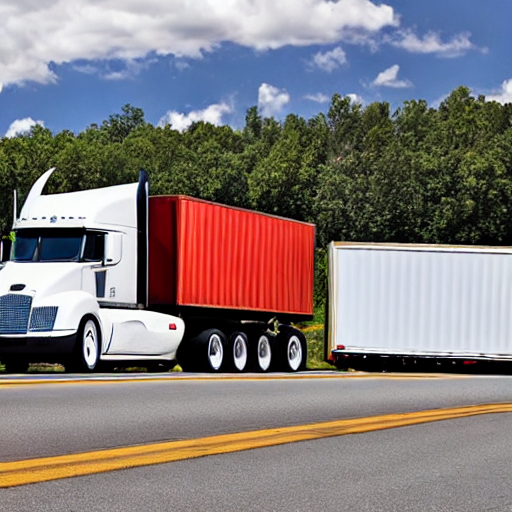

  0%|          | 0/50 [00:00<?, ?it/s]

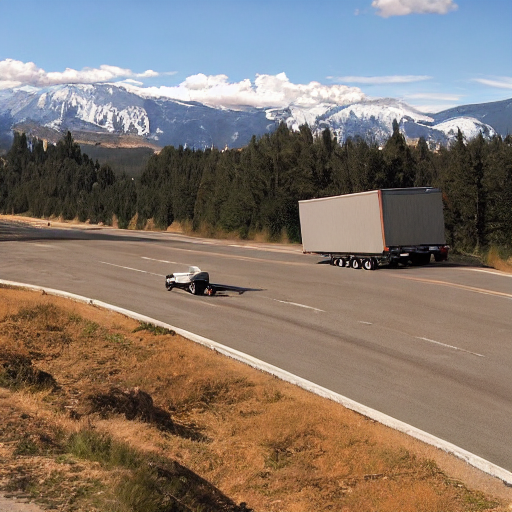

('a dirty train is riding on the tracks', 0.7710596323013306, 0.4995559751987457)


  0%|          | 0/50 [00:00<?, ?it/s]

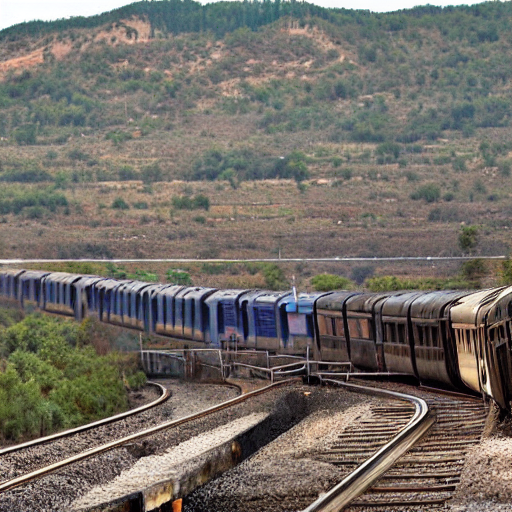

  0%|          | 0/50 [00:00<?, ?it/s]

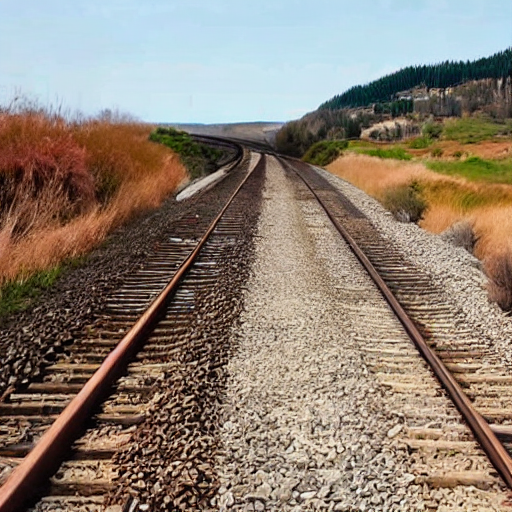

('the train does not look like one that i have seen before.', 0.7705727815628052, 0.45247799158096313)


  0%|          | 0/50 [00:00<?, ?it/s]

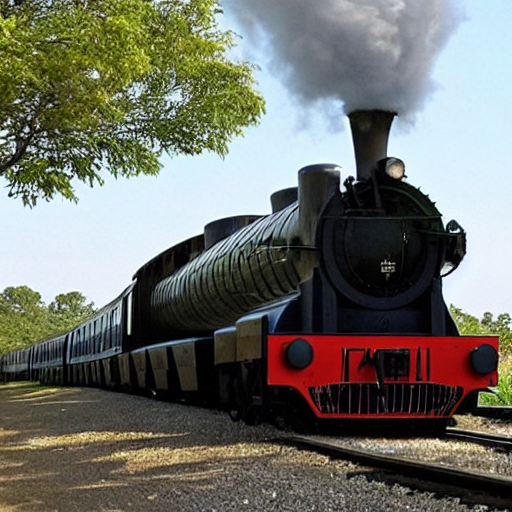

  0%|          | 0/50 [00:00<?, ?it/s]

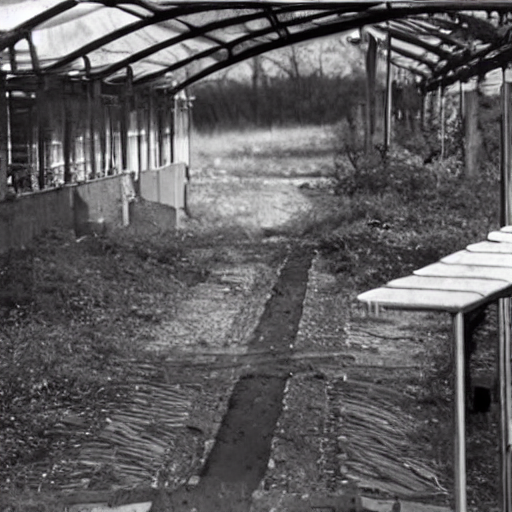

('this is a train coming down the rails', 0.7654106020927429, 0.39034903049468994)


  0%|          | 0/50 [00:00<?, ?it/s]

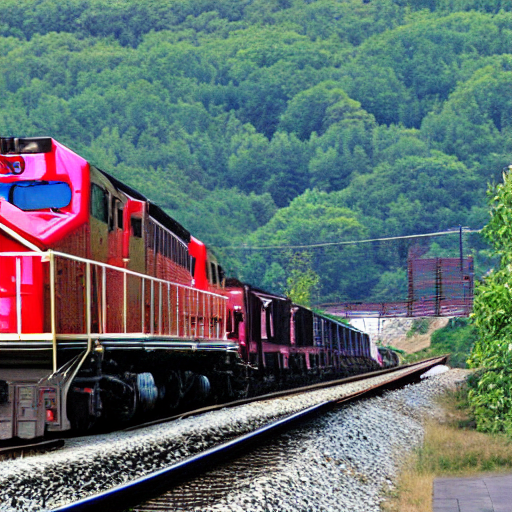

  0%|          | 0/50 [00:00<?, ?it/s]

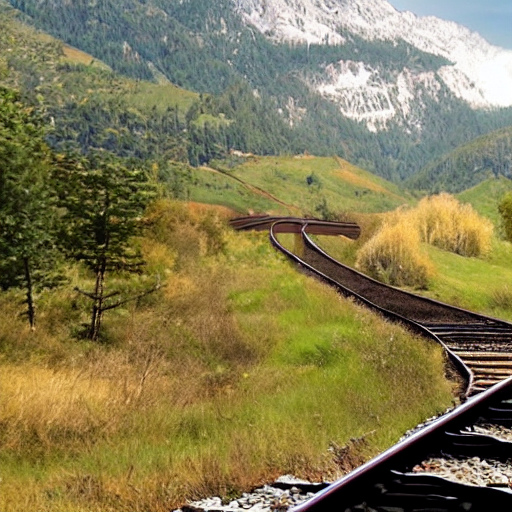

('the large truck is parked by the side of the road.', 0.7644360661506653, 0.4945746660232544)


  0%|          | 0/50 [00:00<?, ?it/s]

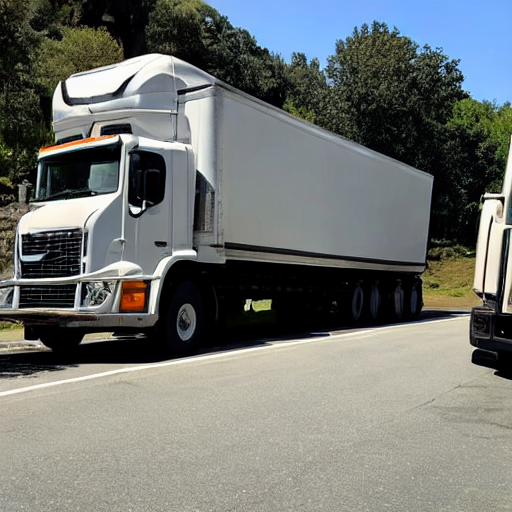

  0%|          | 0/50 [00:00<?, ?it/s]

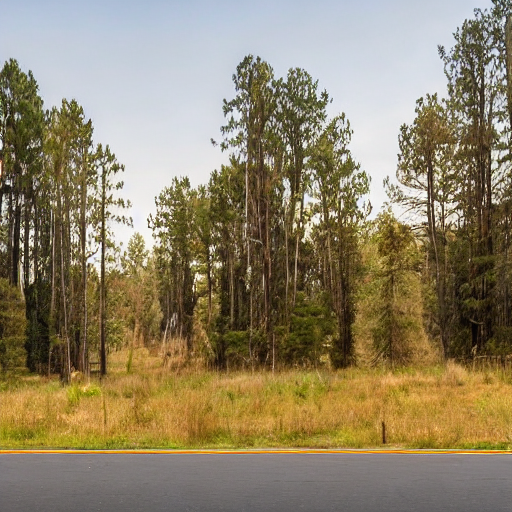

('there is a train that is driving on the tracks', 0.7642518877983093, 0.36328697204589844)


  0%|          | 0/50 [00:00<?, ?it/s]

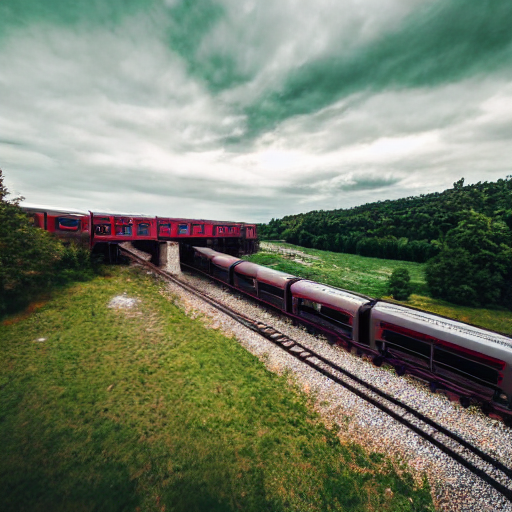

  0%|          | 0/50 [00:00<?, ?it/s]

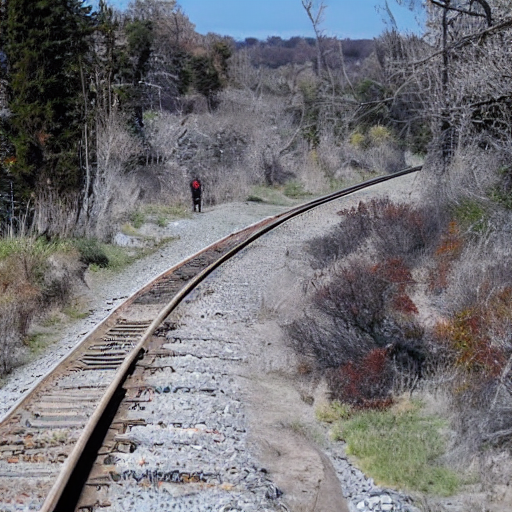

In [54]:
for c in filtered_captions:
    print(c)
    c = c[0]
    image = original_model(c).images[0]
    image.show()
    image = erased_model(c).images[0]
    image.show()

('a truck with a number of people and things in the back', 0.7320618033409119, 0.46716034412384033)


  0%|          | 0/50 [00:00<?, ?it/s]

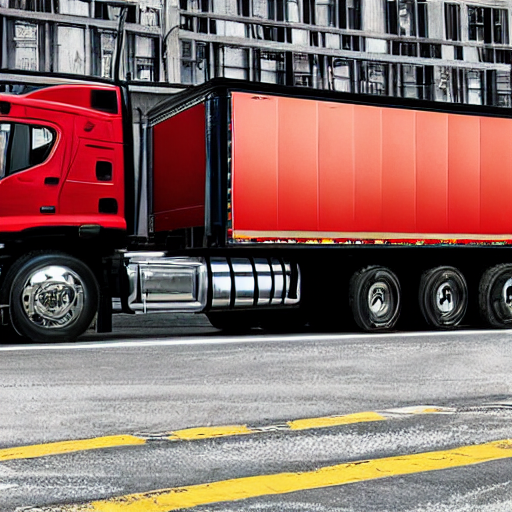

  0%|          | 0/50 [00:00<?, ?it/s]

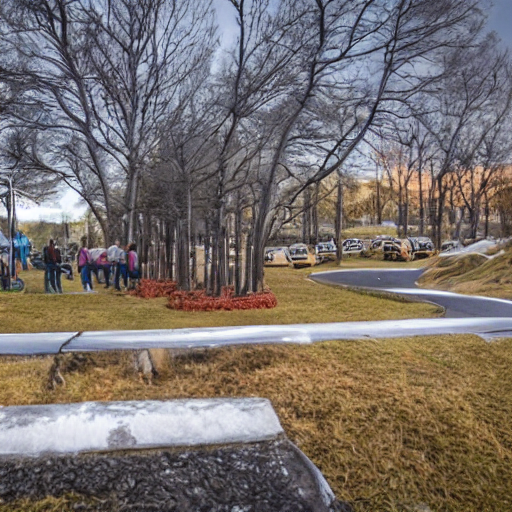

('a truck carries a large amount of items and a few people.', 0.7259083986282349, 0.43126580119132996)


  0%|          | 0/50 [00:00<?, ?it/s]

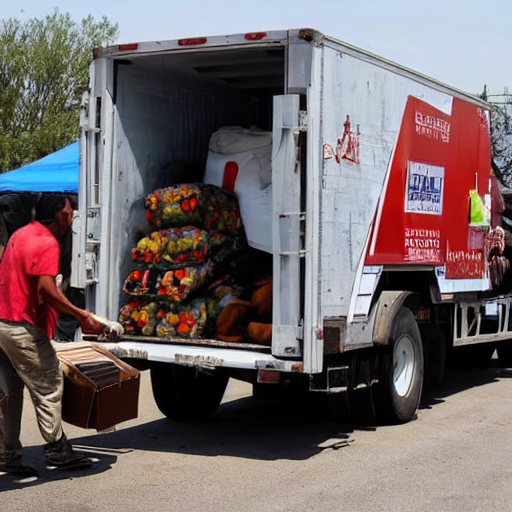

  0%|          | 0/50 [00:00<?, ?it/s]

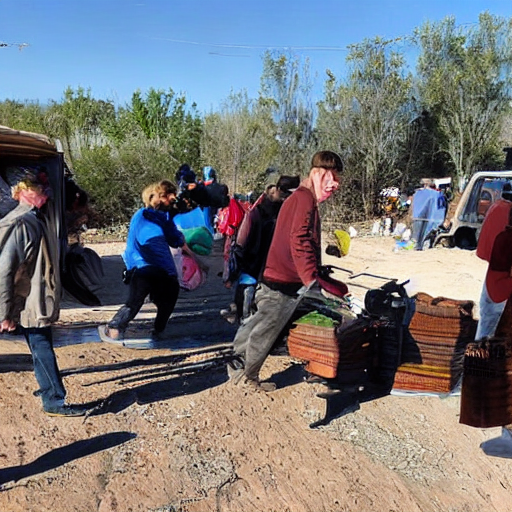

('this is a picture of traffic on a very busy street.', 0.7039392590522766, 0.3900076746940613)


  0%|          | 0/50 [00:00<?, ?it/s]

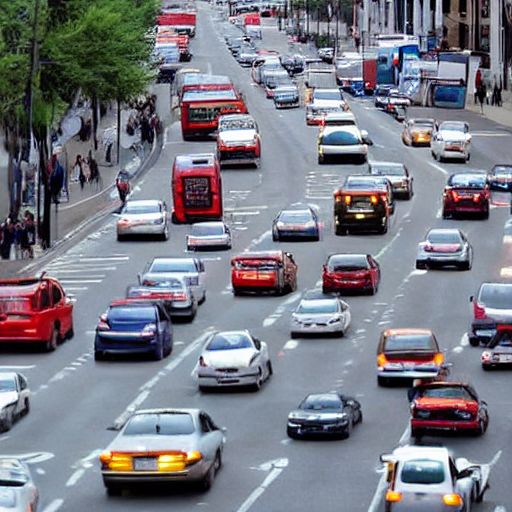

  0%|          | 0/50 [00:00<?, ?it/s]

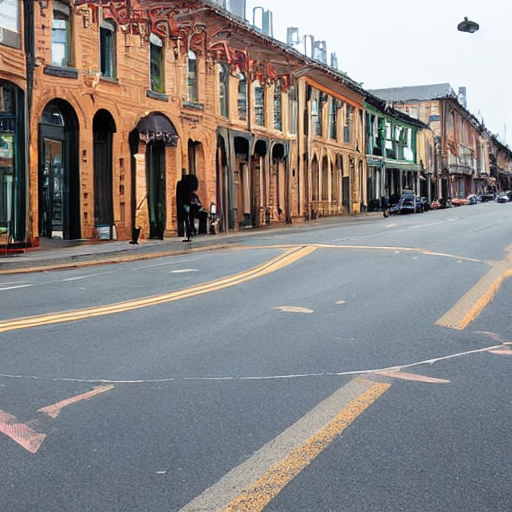

('there is a dump truck and pay loader and construction workers.', 0.746725857257843, 0.4253787696361542)


  0%|          | 0/50 [00:00<?, ?it/s]

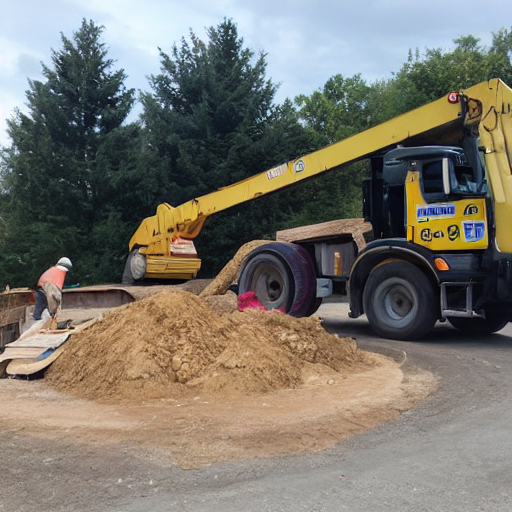

  0%|          | 0/50 [00:00<?, ?it/s]

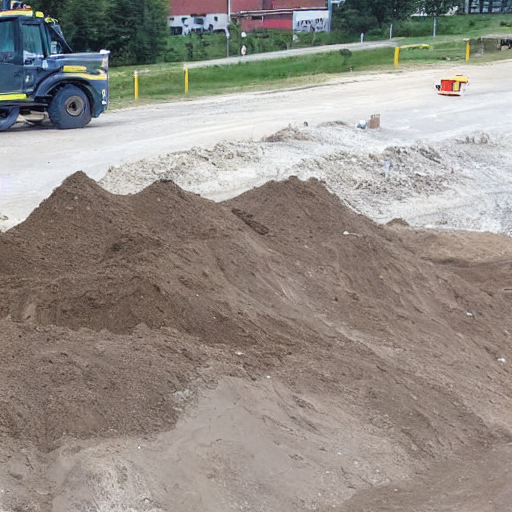

('the tow truck is pulling a care down the street ', 0.7236082553863525, 0.3478339910507202)


  0%|          | 0/50 [00:00<?, ?it/s]

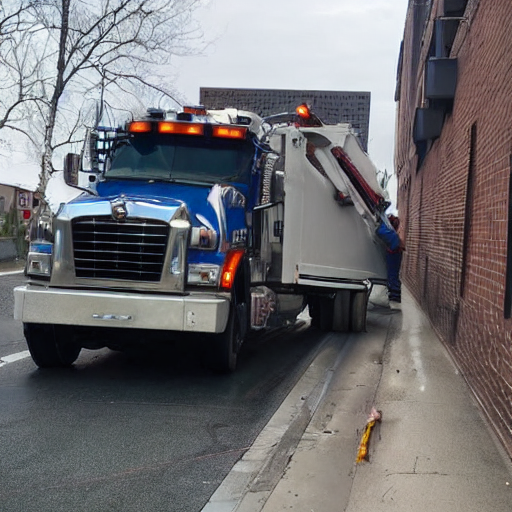

  0%|          | 0/50 [00:00<?, ?it/s]

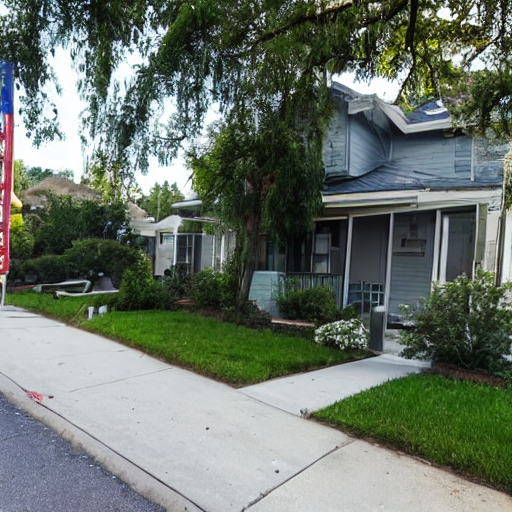

('the truck is hauling a load of bicycles.', 0.7064081430435181, 0.42632001638412476)


  0%|          | 0/50 [00:00<?, ?it/s]

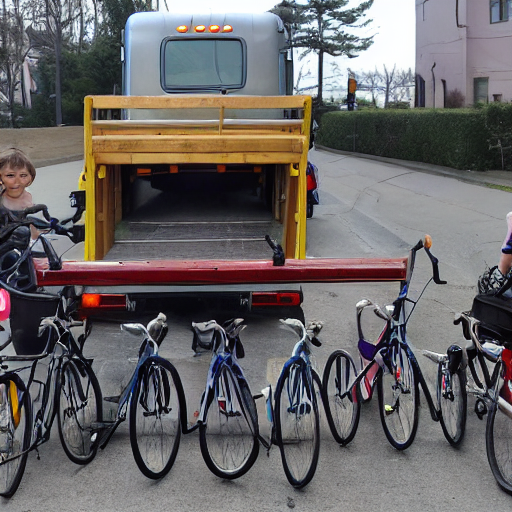

  0%|          | 0/50 [00:00<?, ?it/s]

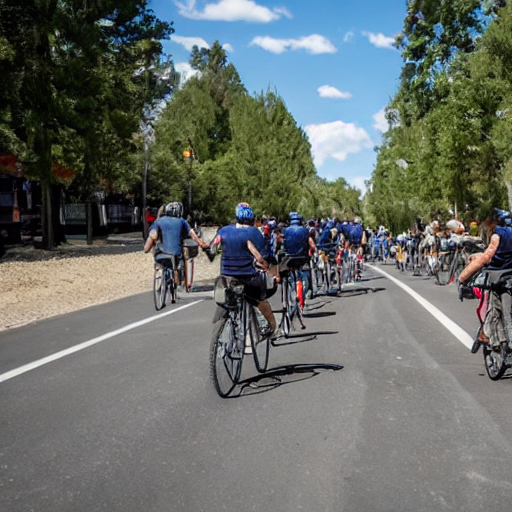

('a picture is a image of an zoo animals.\n', 0.7022067308425903, 0.3719155192375183)


  0%|          | 0/50 [00:00<?, ?it/s]

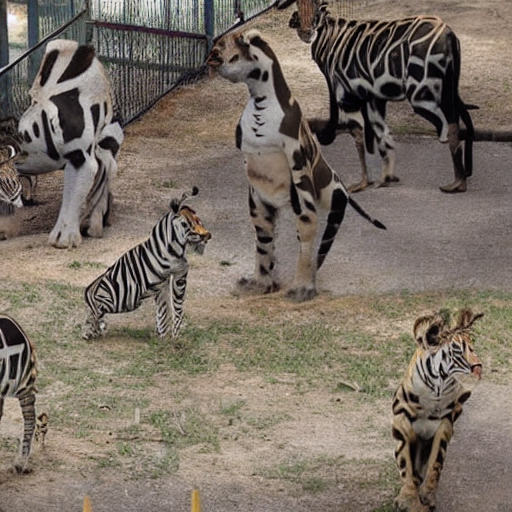

  0%|          | 0/50 [00:00<?, ?it/s]

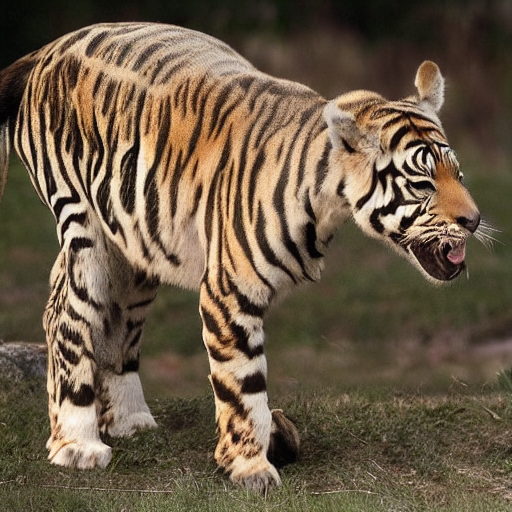

('putting a used toilet out with the trash is certainly not appropriate.', 0.7188431024551392, 0.3584916591644287)


  0%|          | 0/50 [00:00<?, ?it/s]

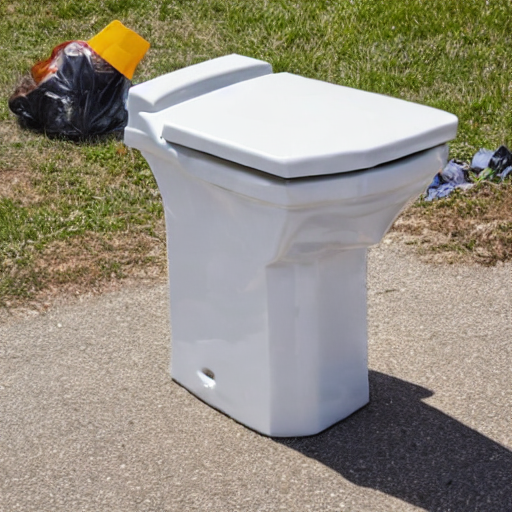

  0%|          | 0/50 [00:00<?, ?it/s]

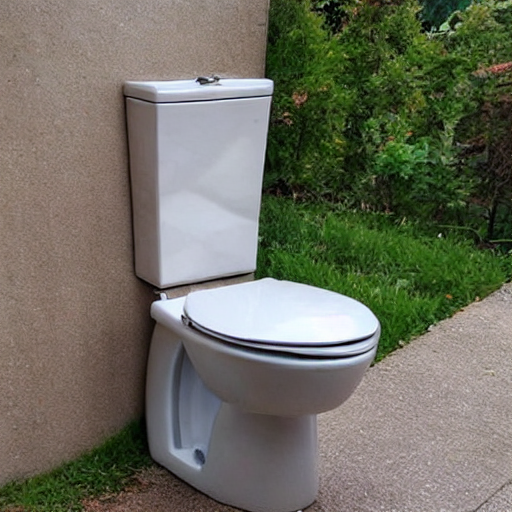

('a bunch of trash and a toilet sitting on a curb ', 0.7287208437919617, 0.45629122853279114)


  0%|          | 0/50 [00:00<?, ?it/s]

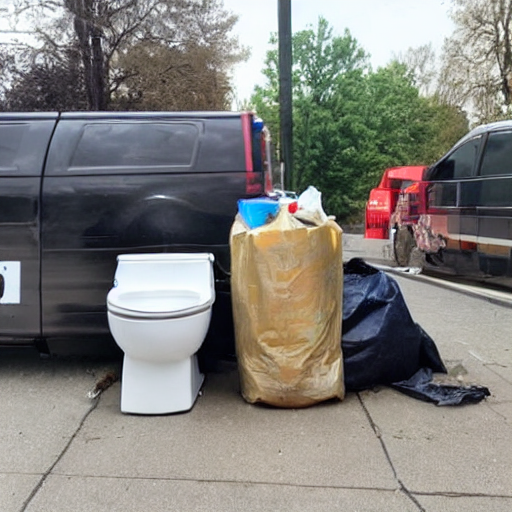

  0%|          | 0/50 [00:00<?, ?it/s]

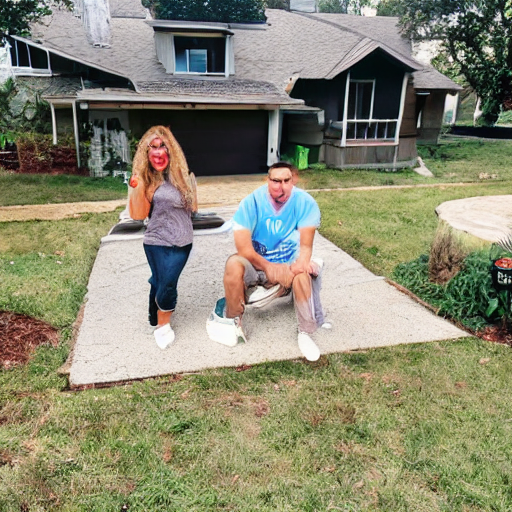

('a bundle of trash with a toilet basin, polythenes and bottles', 0.7102118730545044, 0.36249470710754395)


  0%|          | 0/50 [00:00<?, ?it/s]

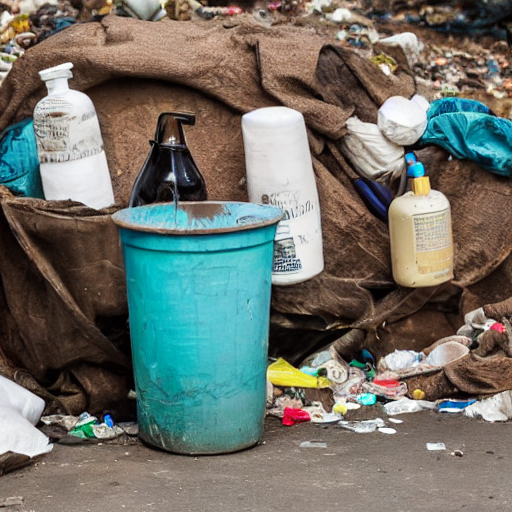

  0%|          | 0/50 [00:00<?, ?it/s]

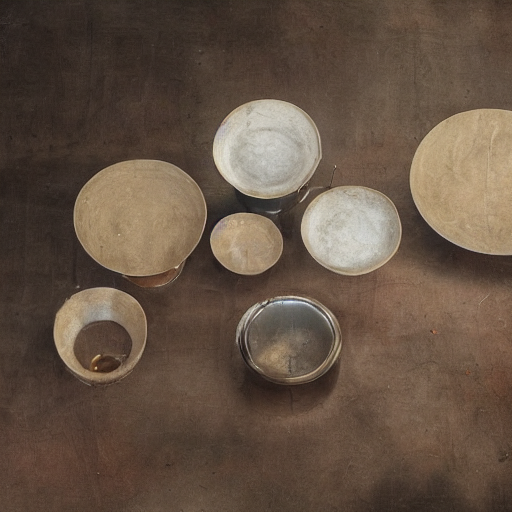

('i am unable to see the image above.', 0.7335954904556274, 0.314947247505188)


  0%|          | 0/50 [00:00<?, ?it/s]

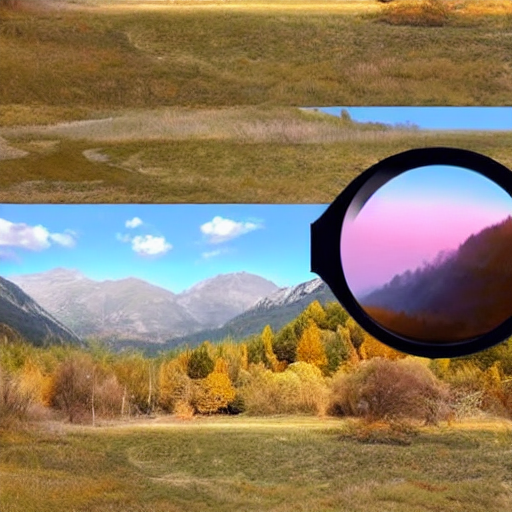

  0%|          | 0/50 [00:00<?, ?it/s]

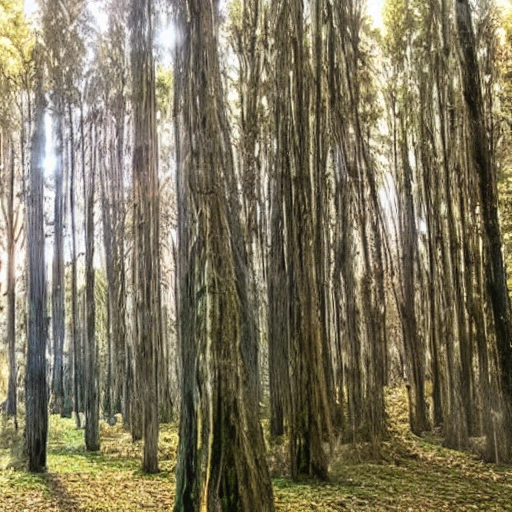

In [29]:
for c in filtered_captions:
    print(c)
    c = c[0]
    image = original_model(c).images[0]
    image.show()
    image = erased_model(c).images[0]
    image.show()

In [11]:
prompt = "Image of a tench"
cap = "Image of a slow-moving fish"
calculate_bert_cosine_sim(prompt,cap,bert_model)

/tmp/ipykernel_2013481/1723560358.py:6: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3683.)
  cosine_sim = torch.matmul(embeddings[0], embeddings[1].T)


0.2731286287307739

In [13]:
calculate_clip_score(prompt, cap, clip_model, clip_processor)

0.6350643038749695

  0%|          | 0/50 [00:00<?, ?it/s]

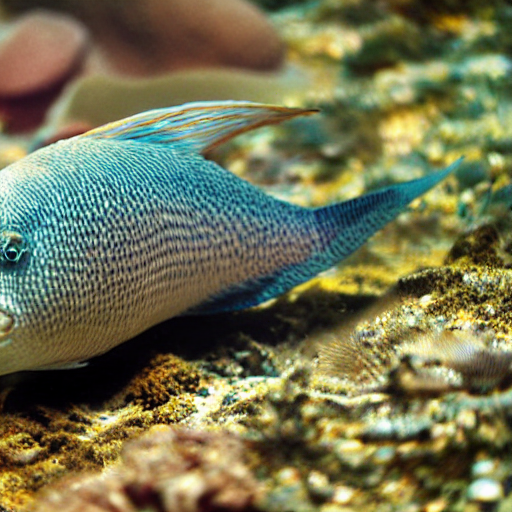

  0%|          | 0/50 [00:00<?, ?it/s]

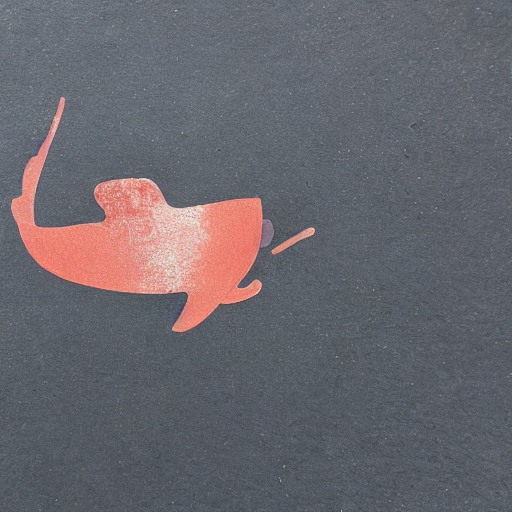

In [14]:
image = original_model(cap).images[0]
image.show()
image = erased_model(cap).images[0]
image.show()

## StableDiffusion 3.5

In [ ]:
import torch
from diffusers import StableDiffusion3Pipeline
import os
import matplotlib.pyplot as plt

home_dir = os.path.expanduser("~")
cache_dir = os.path.join(home_dir, "scratch/SD/") 
model = StableDiffusion3Pipeline.from_pretrained(
    "stabilityai/stable-diffusion-3.5-large",
    torch_dtype=torch.bfloat16,
    cache_dir=cache_dir,
    feature_extractor=None,
)

model = model.to("cuda")


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

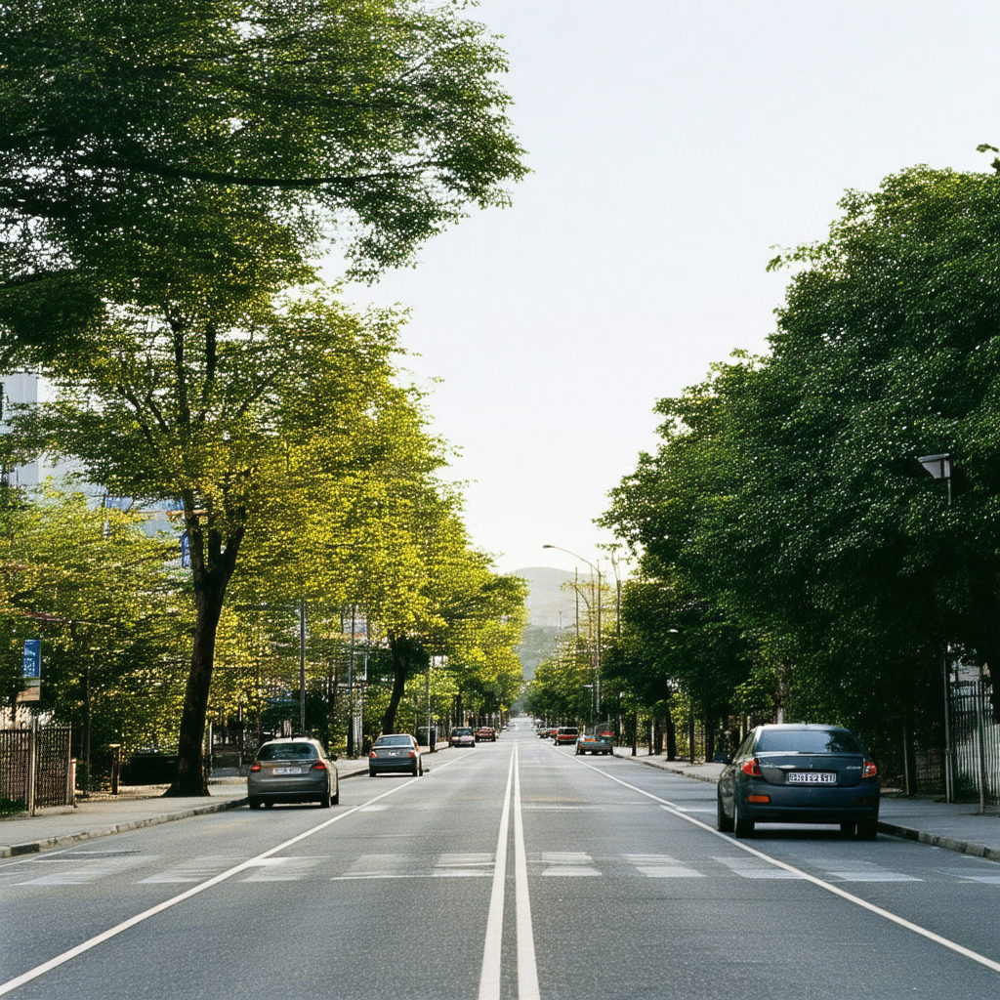

In [54]:
image = model("An street without cars in it").images[0]
image.show()
